---

# INSPIRE Day 1:
---

# Using "a computational microscope" to study protein structure and dynamics, or How to be a molecular detective



# Part I

## 1. Introduction <a id='l_overview'></a>

The goal of today's lecture is to present an introduction of the simulation technique called Molecular Dynamics (MD), as applied to macromolecules. We will learn how to run these simulations using the Python programmming language. We will use many `numpy` functions and a few new modules, such as `openmm` for MD simulations. These are the important concepts that we will cover:

- [Newton's Laws of Motion](#l_newton) 
- [Simulation of Dynamics of Particles](#l_sims)
- [Proteins -- Different Levels of Structure](#l_proteins)
- [Molecular Mechanics](#l_mm)
- [MD Simulations of Proteins](#l_md)


Our end-goal is to investiate how dynamics on the molecular level lead to functional outcomes. Consider for example the adenosine A2A receptor (pictured below) -- how can we interrogate the complex dynamics of this protein using computer simulations? What is our starting point?

<center><img src="pics/a2a.png" width="750"></center>

## 2. Newton's Laws of Motion <a id='l_newton'></a>

Newton's 2nd law connects the kinematics (movements) of a body with its mechanics (total force acting on it) and defines the dynamic evolution of its position: 

$$m\frac{d^2r(t)}{dt^2} = F = - \nabla{U(r)},$$

where $m$ is the mass, $r$ is the position, $F$ is the force and $U(r)$ is the potential energy, which depends only on the position of the body. 
If one knows the forces acting upon the body, one can find the position of the body at any moment $r(t)$, i.e. predict its dynamics. This can be done by solving Newton's equation of motion. It is a second order ODE that can be solved analytically for a few simple cases: constant force, harmonic oscillator, periodic force, drag force, etc.
However, a more general approach is to use computers in order to solve the ODE numerically. Predicting dynamics gives us a powerful tool to study nature.


## 3. Simulation of Dynamics of Particles <a id='l_sims'></a>

There are [many methods](https://en.wikipedia.org/wiki/Numerical_methods_for_ordinary_differential_equations#Methods) for solving ODEs. The second order ODE is transformed to the system of two first order ODEs as follows:

$$\frac{dr(t)}{dt} = v(t)$$

$$m\frac{dv(t)}{dt} = F(t)$$

We use a finite difference approximation that comes to a simple forward Euler Algorithm: 

$$ v_{n+1} = v_n + \frac{F_n}{m} dt$$

$$ r_{n+1} = r_n + v_{n+1} dt$$

Here we discretize time t with time step $dt$, so $t_{n+1} = t_n + dt$, and $r_{n} = r(t_n)$, $v_{n} = v(t_n)$, where $n$ is the timestep number. Using this method, computing dynamics is straightforward.


<img src="pics/Toronto-04.png" width="300" align="right">

### Example 3.1. Simulation of a projectile on Earth

---

We want to know the dynamics of a green apple ($m = 0.3$ kg) tossed horizontally at 10 cm/s speed from the top of the Toronto CN Tower (553 m) for the first 10 seconds.

In [18]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation

# Setup the figure and axes...
fig, ax = plt.subplots(figsize=(3,3), dpi=300, )

plt.title('Apple falling from CN tower (no drag)', fontsize=5)
plt.xlabel('Position (meters)', fontsize=5)
plt.ylabel('Height (meters)', fontsize=5)
plt.xlim(-2,2)
plt.ylim(0, 600)

plt.xticks(fontsize=5)
plt.yticks(fontsize=5)
ax.grid(alpha=0.5, color='gray', ls='--', lw = 1, zorder=10)

## note that the choice of units needs to be consistent such that numerical values are of the appropriate order
# parameters of the problem
T   = 10.    # s
m   = 0.3    # kg
g   = 9.8    # m/s^2
v0x = -0.1   # m/s
H   = 553.   # m

# setting a timestep to be 50 ms
dt = 0.05        # s
N  = int(T / dt) # no. of steps

# Allocating arrays for 2D problem
v = np.zeros((N+1, 2)) # velocities
r = np.zeros((N+1, 2)) # positions
f = np.zeros((N+1, 2)) # forces

# initial conditions, r and v:
r[0] = np.array([0., H])    # set [x,y] array zeroth entries
v[0] = np.array([-v0x, 0.]) # set [x,y] array zeroth entries

# defining forces at each frame; they all are constants, mg
f[:] = np.array([0., -m * g])

## Compute dynamics for each frame using the Euler scheme
for n in range(N):
    v[n+1] = v[n] + f[n]/m * dt
    r[n+1] = r[n] + v[n+1] * dt

## drawing the first data point on the scatter plot, selecting color/size/symbol 
scat = ax.scatter(r[0,0], r[0,1], marker='o', c='deepskyblue', s=150, edgecolor='k', lw=1, zorder=1001)

# a function animate, which updates coordinates of scatter points based on the frame number, i
def animate(i):
    scat.set_offsets(r[i])

# create an animation based on the function animate
ani = animation.FuncAnimation(fig, func=animate, frames=N)
plt.tight_layout()
plt.close() 

C:\Users\wular\anaconda3\envs\inspire24\Lib\site-packages\matplotlib\animation.py:892: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you output the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(


Let's visualize the dynamics using embedded HTML. It's interactive and you can play a movie step by step:

In [19]:
from IPython.display import HTML
HTML(ani.to_jshtml(fps= 1//dt))

### Introducing drag force in the system:

Drag force $F_d = - \gamma v$ is a force acting on a moving object in a mediuum. It always acts in the opposite direction of velocity and slows the paricle down. The magnitude of this force depends on the speed of the particle ($v$), properties of the mediuum and geomtery of the particle, which are incorporated in the coefficient $\gamma$. 

With drag, solving Second Newton's Law ODE analytically is pretty challenging (but possible!):

$$\frac{dr(t)}{dt} = v(t)$$

$$m\frac{dv(t)}{dt} = F(t) - \gamma v(t)$$

We use a forward Euler Algorithm: 

$$ v_{n+1} = v_n + \frac{F_n}{m} dt - \frac{\gamma}{m} v_n dt $$

$$ r_{n+1} = r_n + v_{n+1} dt $$



## Exercise 3.1

Modify the previous code in order to introduce drag to the problem. Use coefficient $\gamma = 0.02$ kg/s.

In [25]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation

# Setup the figure and axes...
fig, ax = plt.subplots(figsize=(3,3), dpi=300, )

plt.title('Apple falling from CN tower (with drag)', fontsize=5)
plt.xlabel('Position (meters)', fontsize=5)
plt.ylabel('Height (meters)', fontsize=5)
plt.xlim(-2,2)
plt.ylim(0, 600)

plt.xticks(fontsize=5)
plt.yticks(fontsize=5)
ax.grid(alpha=0.5, color='gray', ls='--', lw = 1, zorder=10)

# parameters of the problem
T   = 10.  # s
m   = 0.3  # kg
g   = 9.8  # m/s^2
v0x = -0.1 # m/s
H   = 553. # m
gamma = 0.02 # kg/s

# setting a timestep to be 50 ms
dt = 0.05       # s
N = int(T / dt) # No. of steps

# Allocating arrays for 2D problem
v = np.zeros((N+1, 2))
r = np.zeros((N+1, 2))
f = np.zeros((N+1, 2))

# initial conditions, r and v:
r[0] = np.array([0., H])
v[0] = np.array([-v0x, 0.]) # constant v_x

# defining forces at each frame; they all are constants, mg
f[:] = np.array([0., -m * g])

## Compute dynamics for each frame using our updated Euler scheme
for n in range(N):
    v[n+1] = v[n] + f[n]/m * dt - gamma/m * v[n] * dt
    r[n+1] = r[n] + v[n+1] * dt

## drawing the first data point on the scatter plot, selecting color/size/symbol 
scat = ax.scatter(r[0,0], r[0,1], marker='o', c='deepskyblue', s=150, edgecolor='k', lw=1, zorder=1001)

# a function animate, which updates coordinates of scatter points based on the frame number i 
def animate(i):
    scat.set_offsets(r[i])

# create an animation based on the function animate
ani = animation.FuncAnimation(fig, func=animate, frames=N)
plt.tight_layout()
plt.close()

from IPython.display import HTML
HTML(ani.to_jshtml(fps= 1//dt))

## N-body problem -- building towards more complex systems.
---
We can easily simulate a single particle acting in a constant force environment. But proteins are made of thousands, if not millions, of atoms; so, we must increase the complexity of the simulations. We can start by introducing more particles and considering how the forces between the particles act.

When a closed system of particles are interacting through pairwise potentials, the force on each particle $i$ depends on its position with respect to every other particle $j$:

$$m_i\frac{d^2r_i(t)}{dt^2} = \sum_jF_{ij}(t) = -\sum_j\nabla_i{U(|r_{ij}(t)|)}$$

where $r_{ij} = \sqrt{(x_i - x_j)^2 + (y_i - y_j)^2 + (z_i - z_j)^2}$ is the distance between particle $i$ and $j$, and $i,j \in (1,N)$. ! Note that this is just the second law of Newton re-framed as a differential equation to highlight the dependence on different quantities.

### Example 3.2. Simulation of 3-body problem with Hooke's law:

<img src="pics/mx.png" width="300" align="right">

We want to know the dynamics of 3 particles ($m = 1$ kg) connected to each other with invisible springs with spring contants of $k_s = 5$ N/m, and having an equilibrium distance of $r_0 = 1$ m. Let's initially place the particles at (0, 2), (2, 0) and (-1, 0) on the 2D plane for the first 10 seconds of their motion. The particles are initially at rest (no velocity).

**Hint:**
The pairwise potential is (Hooke's Law): $$U(r_{ij}) = \frac{k_s}{2}(r_{ij} - r_0)^2$$

The negative gradient of the potential is a force from $j$-th upon $i$-th: 

$$\mathbf{F_{ij}} = - \nabla_i{U(r_{ij})} = - K_s (r_{ij} - r_0) \nabla_i r_{ij} = - K_s (r_{ij} - r_0) \mathbf{r_{ij}} / r_{ij},$$ which is the familiar spring force that acts on the line between two masses. Recall that \mathbf{r_{ij}} is the unit vector on the line connecting particles $i$ and $j$.


In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation

# Setup the figure and axes...
fig, ax = plt.subplots(figsize=(3,3), dpi=300, )

plt.title('3-body dynamics (no drag)', fontsize=5)
plt.xlabel('Position (meters)', fontsize=5)
plt.ylabel('Position (meters)', fontsize=5)
plt.xlim(-4, 4)
plt.ylim(-4, 4)
plt.xticks(fontsize=5)
plt.yticks(fontsize=5)
ax.grid(alpha=0.5, color='gray', ls='--', lw = 1, zorder=10)

# parameters of the problem
T = 10. # s
m = 1.0 # kg
ks = 5 # N/m
r0 = 1. # m

# setting a timestep to be 50 ms
dt = 0.05 #s
N = int(T / dt)

# Allocating arrays for 2D problem: first axis - time. second axis - particle's number. third - coordinate
v = np.zeros((N+1, 3, 2))
r = np.zeros((N+1, 3, 2))
f = np.zeros((N+1, 3, 2))

# initial conditions for 3 particles:
r[0,0] = np.array([0., 2.])
r[0,1] = np.array([2., 0.])
r[0,2] = np.array([-1., 0.])

def compute_forces(n):
    '''The function computes forces on each pearticle at time step n'''
    for i in range(3):
        for j in range(3):
            if i != j:
                rij = r[n,i] - r[n,j]
                rij_abs = np.linalg.norm(rij)
                f[n, i] -= ks * (rij_abs - r0) * rij / rij_abs 

## Run dynamics:
for n in range(N):
    compute_forces(n)
    v[n+1] = v[n] + f[n]/m * dt
    r[n+1] = r[n] + v[n+1] * dt

## drawing and animating 
colors_bupu = ['#f7fcfd', '#e0ecf4', '#bfd3e6', '#9ebcda', '#8c96c6', '#8c6bb1', '#88419d', '#810f7c', '#4d004b']
scat = ax.scatter(r[0,:,0], r[0,:,1], marker='o', edgecolor='k', c=[colors_bupu[0], colors_bupu[5], colors_bupu[-1]], s=500, zorder=1001)

def animate(i):
    scat.set_offsets(r[i])

ani = animation.FuncAnimation(fig, animate, frames=N)
plt.tight_layout()
plt.close()

Again, looking at the trajectory representation in real time:

In [2]:
# create an HTML page with a simulation
from IPython.display import HTML
HTML(ani.to_jshtml(fps= 1//dt))

## Exercise 3.2. 3-body problem with a drag.
Introduce drag force to the 3-body problem. Use coefficient $\gamma = 0.3$ kg/s. Visually compare the dynamics of the dragged particles to the dynamics of particles which did not experience resistance from the medium. 

In [16]:
# Your code and explanation here

## Exercise 3.3. 3-body problem with a drag and initial velocity.
Modify the previous code by introducing an initial velocity $v_0 = (0, -0.2)$ for the particle located at position (0, 2). How does the behavior of the system change?

In [ ]:
# Your code and explanation here

## Exercise 3.4. Adding a random force.

The effect of solvent at specific temperature on particle is usually simulated by a random force $\vec{R}(t)$. This force is proportional to $k_B T$, where $T$ is temperature of the solvent and $k_B$ - is a Boltzman constant. Brownian motion is an example of this effect. To implement this process in our simulations, we will generate a normally distributed random number ~ $N(0, 1)$ (with $\mu = 0$ and $\sigma = 1$) in each dimension for each paticle at every time step, which will represent a random force $\vec{R}(t)$ at time $t$. 
 
With drag and random force, ODE for each particle becomes:

$$\frac{dr(t)}{dt} = v(t)$$

$$m\frac{dv(t)}{dt} = F(t) - \gamma v(t) + R(t)$$

$$R(t) = k_BT N(0,1)$$

where $k_B = 1$ and $T = 2$.

We use the forward Euler algorithm again: 

$$ v_{n+1} = v_n + \frac{F_n}{m} dt - \frac{\gamma}{m} v_n dt + \frac{k_{B}T}{m}N(0, 1) dt$$

$$ r_{n+1} = r_n + v_{n+1} dt $$


In [ ]:
# Your code and explanation is here:

## Exercise 3.5. Analysis of the simulations
Analyze particles' dynamics in example 3.2 and exercises 3.2-3.4, with a total of 4 cases: 
- (i) 3-body with no drag,
- (ii) 3-body with a drag, 
- (iii) 3-body with a drag and an initial velocity,
- (iv) 3-body with a drag and a random force.  

Plot (1) the position of center of mass $r_{CM}$ (x and y components individually), (2) total kinetic energy $K$, and (3) total mechanical energy $U + K$ of this system as a function of time? Discuss your results.

In [ ]:
# Your code and explanation is here:

## Hands-on 1. Simulation of a projectile.

<img src="pics/dinho.jpg" width="30%" align='right'>
Read through sections 2-3 and example 3.1 of the lecture. Write a program that simulates the 2-s motion of a football (soccer ball) ($m = 15$ ounces) kicked by the greatest football player to have ever lived, Ronaldinho. Assume it is kicked from a height of $H=8$ feet (more fun) at speed $V=60$ MPH and at 30 degrees above to the horizontal. Use the drag coefficient $\gamma$ = 0.02. Using relations from kinematics, create this simulation.

**Hint**. Be careful to use SI units!

In [3]:
# Your solution here.

## Hands on 2. Simulation of a 4-body problem.

Write a program that simulates the 10-s dynamics of **4** particles, each with $m = 0.5$ kg, initially located at the corners of the square (0,0), (0, 2), (2, 0) and (2, 2) on the 2D plane with initial velocities (0, 0.1), (0, 0.2), (-0.2, 0) and (0.2, -0.25) m/s. The particles are connected to each other with invisible springs with $K_s = 8$ N/m, and $r_0 = 2$ m. Drag coefficient is 0.2. Do not simulate random force. 

Analyze the system's $r_{CM}$, $K$ and $U$ as a function of time. 

In [18]:
# Your code and explanation is here:

# Break
---

# Part II. 

We have just built a pipeline to simulate much larger systems, which have thousands and millions of particles. Characterizing behaviour of such systems is essentially called molecular dynamics (MD) simulations. 

Molecular dynamics simulations have many applications in various fields, including:

- **Structural biology:** MD simulations can be used to study the dynamics of proteins and other biomolecules, allowing researchers to understand their function and behavior at an atomic level. For example, MD simulations have been used to study the binding of drugs to proteins and the dynamics of enzymes.

- **Drug discovery:** MD simulations can be used to screen potential drug candidates and predict their binding affinity to a target protein. This can help researchers identify promising drug candidates before they are tested in vitro or in vivo.

- **Materials science:** MD simulations can be used to study the properties of materials at the atomic level, allowing researchers to design new materials with specific properties.


While we now have a basic knowledge of the purpose and methodology of simulations, we still need to talk aboout important biological systems for which MD simulations are the most useful.

---
## 4. Proteins, structure and functions <a id='l_proteins'></a>
---
<img src="pics/Protein_structure.png" width="400" align="right">

[Protein structure](https://en.wikipedia.org/wiki/Protein_structure) is the three-dimensional arrangement of atoms in a protein, which is a chain of amino acids. Proteins are polymers – specifically polypeptides – formed from sequences of 20 types of amino acids, the monomers of the polymer. A single amino acid monomer may also be called a residue, indicating a repeating unit of a polymer. To be able to perform their biological function, proteins fold into one or more specific spatial conformations driven by a number of non-covalent interactions such as:

- hydrogen bonding 
- ionic interactions 
- Van der Waals forces
- hydrophobic packing 

To understand the functions of proteins at a molecular level, it is often necessary to determine their three-dimensional structure using techniques such as X-ray crystallography, NMR spectroscopy, and others.

### 4.1 Levels of structure:

**Primary structure** of a protein refers to the sequence of amino acids in the polypeptide chain.

**Secondary structure** refers to highly regular local sub-structures of the actual polypeptide backbone chain. There are two main types of secondary structure: the α-helix and the β-strand or β-sheets.

**Tertiary structure** refers to the three-dimensional structure of monomeric and multimeric protein molecules. The α-helixes and β-sheets are folded into a compact globular structure. 

**Quaternary structure** is the three-dimensional structure consisting of two or more individual polypeptide chains (subunits) that operate as a single functional unit (multimer).


### 4.2 Functions:

- *Antibodies* - bind to specific foreign particles, ex: IgG 
- *Enzymes* - speed up chemical reactions, ex: Lysozyme
- *Messengers* - transmit signals, ex: Growth hormone 
- *Structural components* - support for cells, ex: Tubulin
- *Transport/storage* - bind and carry small molecules, ex: Hemoglobin


**Lysozyme** is a protein-enzyme (found in tears, saliva, mucus and egg white) that is a part of the innate immune system with antimicrobial activity characterized by the ability to damage the cell wall of bacteria. Bacteria have polysaccharides (sugars) in their cell wall, that bind to the groove, and lysozyme cuts the bond and destroys bacteria.  

|  ![Protein Sequence in DNA](pics/LysozymeSequence.png) | ![Protein Structure](pics/LysozymeStructure.gif) | ![Protein Strucure with Sugar](pics/LysozymeRock.gif) |
|:-:|:-:|:-:|
|  Sequence | Structure | Function  |

Figure credit: [C.Ing](https://github.com/cing/HackingStructBiolTalk) and [wikipedia](https://en.wikipedia.org/wiki/Protein_structure)


---
## 5. Molecular Mechanics <a id='l_mm'></a>
---

Since we now know what proteins are and why these molecular machines are important, we consider the method to model them. The basic idea is to create the same kind of approach as we used in the 3-body simulation. Now, our system consists of thousands particles (atoms of the protein plus atoms of surrounding water) and they all are connected via a complex potential energy function.

An all-atom potential energy function $V$ is usually given by the sum of the bonded terms ($V_b$) and non-bonded terms ($V_{nb}$), i.e.

$$V = V_{b} + V_{nb},$$

where the bonded potential includes the harmonic (covalent) bond part, the harmonic angle and
the two types of torsion (dihedral) angles: proper and improper. As it can be seen, these functions are mostly harmonic potentials 

$$V_{b} = \sum_{bonds}\frac{1}{2}K_b(b-b_0)^2 + \sum_{angles}K_{\theta}(\theta-\theta_0)^2 + \sum_{dihedrals}K_{\phi}(1-cos(n\phi - \phi_0)) + \sum_{impropers}K_{\psi}(\psi-\psi_0)^2$$

For example, $b$ and $\theta$ represent the distance between two atoms and the angle between two
adjacent bonds; $\phi$ and $\psi$ are dihedral (torsion) angles. These can be evaluated for all the
atoms from their current positions. Also, $K_b$, $K_\theta$, $K_\phi$, and $K_\psi$ are the spring constants, associated
with bond vibrations, bending of bond angles, and conformational fluctuations in dihedral and
improper angles around some equilibrium values $b_0$, $\theta_0$, $\phi_0$, and $\psi_0$, respectively. 

The non-bonded part of the potential energy function is represented by the electrostatic and van der Waals potentials, i.e.

$$V_{nb} = \sum_{i,j}\left(\frac{q_{i}q_{j}}{4\pi\varepsilon_{0}\varepsilon r_{ij}} + \varepsilon_{ij}\left[\left(\frac{\sigma^{min}_{ij}}{r_{ij}}\right)^{12}-2\left(\frac{\sigma^{min}_{ij}}{r_{ij}}\right)^{6}\right]\right)$$

where $r_{ij}$ is the distance between two interacting atoms, $q_i$ and $q_j$ are their electric charges; $\varepsilon$ and
$\varepsilon_0$ are electric and dielectric constant; $\varepsilon_{ij} = \sqrt{\varepsilon_i\varepsilon_j}$ and
$\sigma_{ij} = \frac{\sigma_i + \sigma_j}{2}$ are van der Waals parameters for atoms $i$ and $j$.

**Importantly, each force field has its own set of parameters, which are different for different types of atoms.**

![](pics/ff.png)


## 6. Molecular dynamics of proteins <a id='l_md'></a>
---

[**Molecular dynamics (MD)**](https://en.wikipedia.org/wiki/Molecular_dynamics) is a computer simulation method for studying the physical movements of atoms and molecules, i.e. their dynamical evolution. 

In the most common version, the trajectories of atoms and molecules are determined by numerically solving Newton's equations of motion for a system of interacting particles, where forces between the particles and their potential energies are often calculated using  [molecular mechanics force fields](#l_mm). 



Now with all that intellectual equipment, we can start running legit Molecular Dynamics simulations. All we need is an initial structure of the protein and software that computes its dynamics efficiently.


### Procedure:
1. Load initial coordinates of protein atoms (from `*.pdb` file)
2. Choose force field parameters (in potential function V from section 5).
3. Choose parameters of the experiment: temperature, pressure, box size, solvation, boundary conditions
4. Choose integrator, i.e. algorithm for solving equation of motion
5. Run simulation, save coordinates time to time (to `*.dcd` file).
6. Visualize the trajectory 
7. Perform the analysis

These are the Python libraries we are going to need today:

1. [nglview](http://nglviewer.org/nglview/latest/index.html#installation) - module to visualize molecules
2. [mdanalysis](https://www.mdanalysis.org/pages/installation_quick_start/) - module to analyze MD trajectory
3. [openmm](http://docs.openmm.org/latest/userguide/application.html#installing-openmm) - module to run MD simulation

In [1]:
from openmm.app import *
from openmm import *
from openmm.unit import *
from sys import stdout

In [2]:
from simtk.openmm.app import *
from simtk.openmm import *
from simtk.unit import *
from sys import stdout

In [56]:
import MDAnalysis as md
# import nglview as ng

These files are preloaded to your `data` folder.

In [4]:
pdb0_file = 'data/villin_water.pdb'
pdb1_file = 'data/polyALA.pdb'
pdb2_file = 'data/polyGLY.pdb'
pdb3_file = 'data/polyGV.pdb'

PDB files contain 3D structures of proteins that were resolved by experimental techniques. They can be downloaded from [ProteinDataBank](https://www.wwpdb.org/). Here we can see what a `.pdb` file looks like: 

In [5]:
file0 = open(pdb1_file, 'r')
counter = 0
for line in file0:
    if counter < 10:
        print(line)
    counter += 1

REMARK   1 CREATED WITH OPENMM 7.3, 2019-02-21

ATOM      1  N   ALA A   1     -36.266 -23.426  -2.296  1.00  0.00           N  

ATOM      2  H   ALA A   1     -36.618 -24.370  -2.382  1.00  0.00           H  

ATOM      3  H2  ALA A   1     -36.620 -23.009  -1.447  1.00  0.00           H  

ATOM      4  H3  ALA A   1     -36.591 -22.873  -3.082  1.00  0.00           H  

ATOM      5  CA  ALA A   1     -34.817 -23.426  -2.296  1.00  0.00           C  

ATOM      6  HA  ALA A   1     -34.451 -23.931  -1.402  1.00  0.00           H  

ATOM      7  C   ALA A   1     -34.294 -21.997  -2.296  1.00  0.00           C  

ATOM      8  O   ALA A   1     -34.784 -21.155  -3.046  1.00  0.00           O  

ATOM      9  CB  ALA A   1     -34.255 -24.128  -3.529  1.00  0.00           C  



We can look at the protein in ChimeraX by downloading the structure (.pdb) file:

In [7]:
u = md.Universe(pdb1_file)
# ng.show_mdanalysis(u, gui=True)

### Example 6.1. MD simulation of a peptide folding into alpha-helix
---

Run a simulation of fully extended polyalanine `polyALA.pdb` for 400 picoseconds in a implicit solvent environment with T=300 K and see if it can fold to any secondary  structure:

In [8]:
# 1.loading initial coordinates
pdb = PDBFile(pdb1_file) 

# 2.choosing a forcefield parameters
ff = ForceField('amber14-all.xml')  
system = ff.createSystem(
    pdb.topology, 
    nonbondedMethod=CutoffNonPeriodic
)

# 3. Choose parameters of the experiment: temperature, pressure, box size, solvation, boundary conditions, etc
temperature = 300 * kelvin
frictionCoeff = 1. / picosecond
time_step = 0.002 * picoseconds
total_steps = 400 * picoseconds / time_step

print('Total timesteps = ', total_steps)

# 4. Choose an algorithm (integrator)
integrator = LangevinIntegrator(temperature, frictionCoeff, time_step)

Total timesteps =  200000.0


![](pics/Langevin.png)

In [9]:
# 5. Run simulation, saving coordinates time to time:

# 5a. Create a simulation object
simulation = Simulation(pdb.topology, system, integrator)
simulation.context.setPositions(pdb.positions)

# 5b. Minimize energy
simulation.minimizeEnergy()

# 5c. Save coordinates to dcd file and energies to a standard output console:
simulation.reporters.append(XTCReporter('data/polyALA_traj.xtc', 1000))
simulation.reporters.append(StateDataReporter(
    stdout,
    5000,
    step=True, 
    potentialEnergy=True,
    temperature=True,
    progress=True,
    totalSteps = total_steps
))

In [10]:
# 5d. Run!
simulation.step(total_steps)

#"Progress (%)","Step","Potential Energy (kJ/mole)","Temperature (K)"
2.5%,5000,5341.140106201172,307.98717673272085
5.0%,10000,5224.762390136719,300.0501379855213
7.5%,15000,5387.2144775390625,284.28808671393136
10.0%,20000,5121.378234863281,283.3932794494708
12.5%,25000,5050.744598388672,326.8543638456082
15.0%,30000,5081.46240234375,269.92181805157327
17.5%,35000,5017.507751464844,270.9069171513548
20.0%,40000,5136.683532714844,269.31665475804687
22.5%,45000,4992.164947509766,312.79954885664927
25.0%,50000,5035.96435546875,318.89134574238597
27.5%,55000,4907.399475097656,294.80797497570177
30.0%,60000,4862.6044921875,313.83513447522074
32.5%,65000,4872.700866699219,318.03839516391395
35.0%,70000,4818.962951660156,312.7712156124561
37.5%,75000,4879.077331542969,273.981421431457
40.0%,80000,4898.499572753906,293.9564380097993
42.5%,85000,4842.8468017578125,296.5479084554486
45.0%,90000,4820.805419921875,310.63387784373657
47.5%,95000,4790.25537109375,335.82737182822564
50.0%,100000,48

**Visualization**

Let's look at the trajectory:

In [11]:
# 6. Visualization
sys = md.Universe(pdb1_file, 'data/polyALA_traj.dcd')
# ng.show_mdanalysis(sys, gui=True)

C:\Users\wular\anaconda3\envs\inspire24\Lib\site-packages\MDAnalysis\coordinates\DCD.py:165: DeprecationWarning: DCDReader currently makes independent timesteps by copying self.ts while other readers update self.ts inplace. This behavior will be changed in 3.0 to be the same as other readers. Read more at https://github.com/MDAnalysis/mdanalysis/issues/3889 to learn if this change in behavior might affect you.
  warnings.warn("DCDReader currently makes independent timesteps"


### Example 6.2. Analysis of MD simulation conditions

Let's plot temperature $T$ and potential energy $V$ vs time:

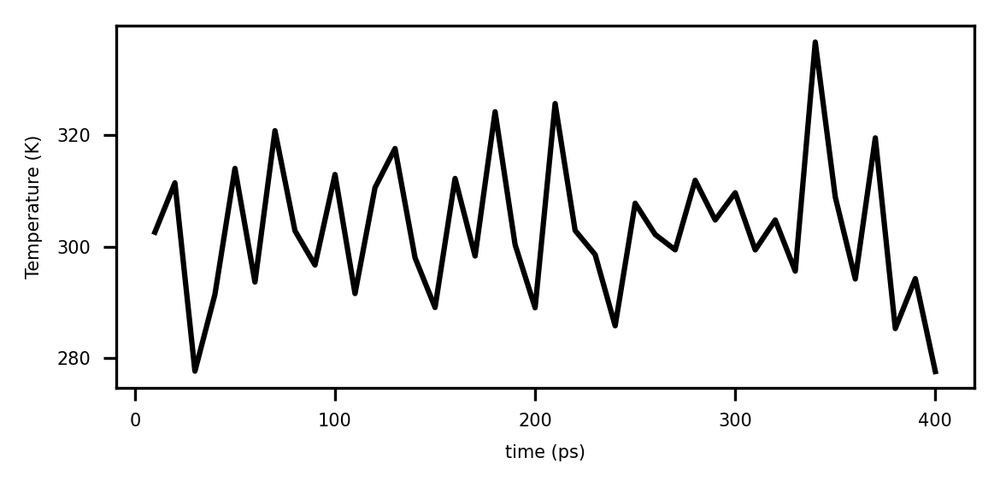

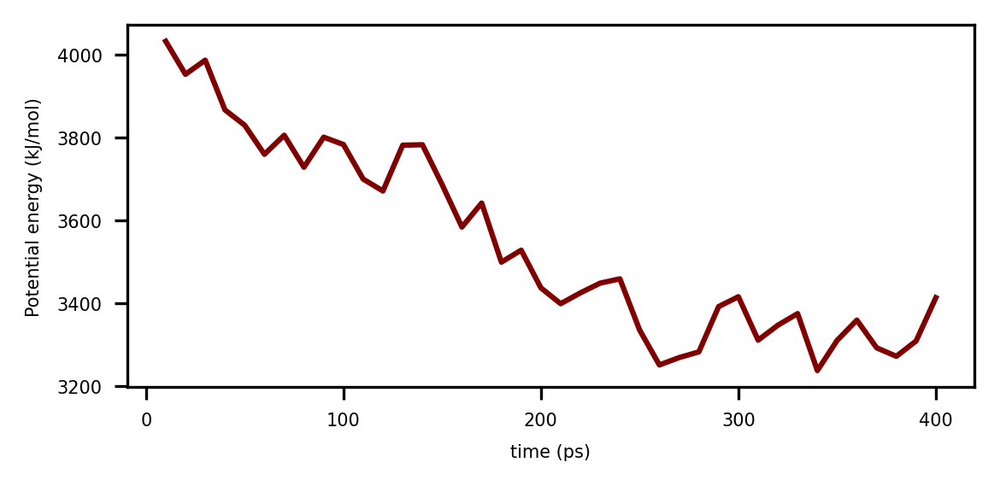

In [36]:
# Let's copy the text output of the simulation into a new file 'data/output.csv':
import numpy as np
import matplotlib.pyplot as plt

output = np.loadtxt('data/output.csv', delimiter=',', usecols=[1,2,3], dtype=float)

time = output[:, 0] * 0.002
energy_V = output[:, 1]
temperature_T = output[:, 2]

plt.figure(figsize=(4, 2), dpi=300)
plt.plot(time, temperature_T, color='k')
plt.xlabel('time (ps)', fontsize=5)
plt.ylabel('Temperature (K)', fontsize=5)
plt.xticks(fontsize=5)
plt.yticks(fontsize=5)
plt.tight_layout()
plt.show()

plt.figure(figsize=(4, 2), dpi=300)
plt.plot(time, energy_V, label='$V$', color='maroon')
plt.ylabel('Potential energy (kJ/mol)', fontsize=5)
plt.xlabel('time (ps)', fontsize=5)
plt.xticks(fontsize=5)
plt.yticks(fontsize=5)
plt.tight_layout()
plt.show()


### Exercise 6.3. Structure prediction
---
Find several online tools that predict protein structure given a sequence: `AAAAAAAAAAAAAAAAAAAAAAAAA`. Test some of them and compare with the results of your simulation. How well do they agree?

Examples: RaptorX, RosettaFold, AlphaFold, etc.

### Example 6.2. Analysis of MD trajectory.
---
Now we can carry out the analysis of the simulation. Let's look at the protein end-to-end distance over time.
**End-to-end distance**:

In [13]:
### analysis of end-to-end distance

## choose terminal atoms 
N_terminus = sys.select_atoms('resid 1 and name N')
C_terminus = sys.select_atoms('resid 25 and name C')

## go through the whole trajectory and compute distance between them for every frame
dist = []
for frame in sys.trajectory:
    dist.append(np.linalg.norm(N_terminus.positions - C_terminus.positions))

## the result is in the dist array    
dist = np.array(dist) 

We can plot end-to-end distance vs time:

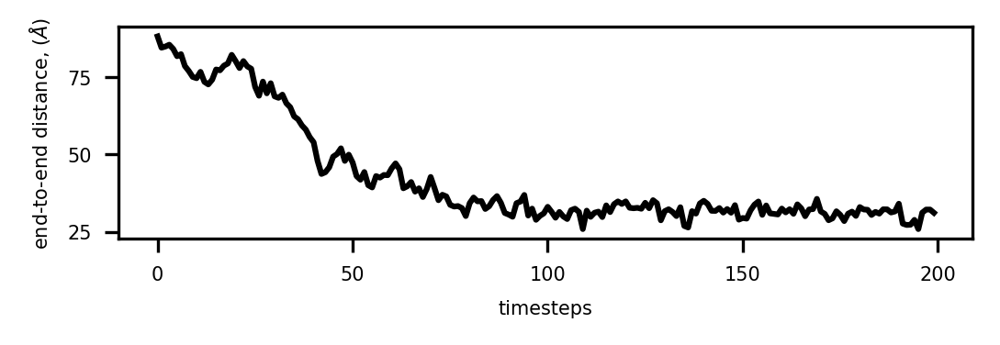

In [25]:
plt.figure(figsize=(4, 1), dpi=300)

plt.plot( dist, '-k' )
plt.xlabel('timesteps', fontsize=5)
plt.xticks(fontsize=5)
plt.yticks(fontsize=5)
plt.ylabel(r'end-to-end distance, ($\AA$)', fontsize=5)

plt.show()

**[Ramachandran plot](https://en.wikipedia.org/wiki/Ramachandran_plot):**

Text(30, 145, 'beta region')

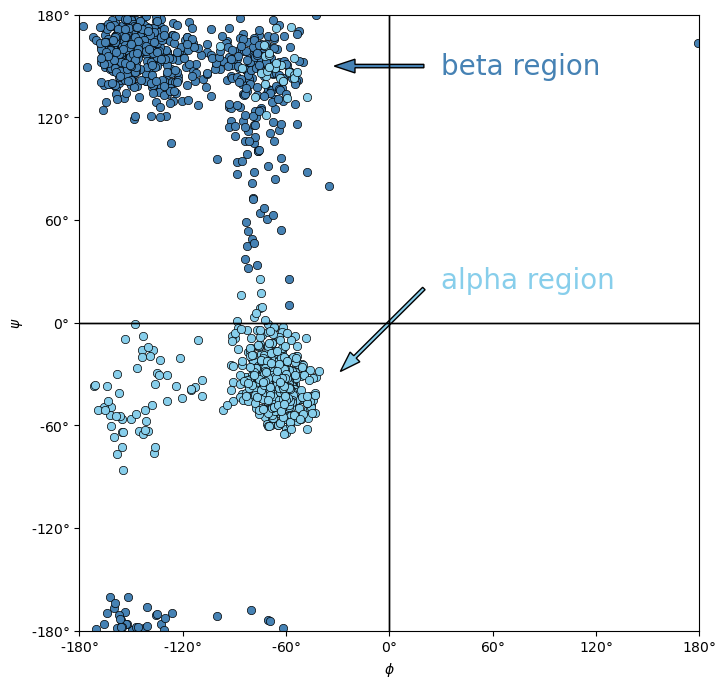

In [55]:
from MDAnalysis.analysis import dihedrals  ## module for dihedrals analysis

ram1 = dihedrals.Ramachandran(sys).run(0,30) ## analyse for first 30 steps (black color)
ram2 = dihedrals.Ramachandran(sys).run(170,200) ## analyse for last 30 steps (blue color)

## ramachandran plot
fig, ax = plt.subplots(figsize=(8,8))
ram1.plot(ax=ax, color='steelblue', edgecolor='k', lw=0.5)
ram2.plot(ax=ax, color='skyblue', edgecolor='k', lw=0.5)
ax.arrow(20, 20, -40, -40, width=2, head_width=8, head_length=12, fc='skyblue', ec='k')
ax.text(30, 20, 'alpha region', color='skyblue', fontsize=20)
ax.arrow(20, 150, -40, 0, width=2, head_width=8, head_length=12, fc='steelblue', ec='k')
ax.text(30, 145, 'beta region', fontsize=20, color = 'steelblue')

<hr>

## Hands-on 3. Your first MD simulation.

Read through section 6 and example 6.1-6.2 of the lecture. Run 3 simulations of fully extended polyglycine `data/polyGLY.pdb` for 1 nanosecond (where water is described implicitly) at $T_1=200 K$, $T_2=300 K$, and $T_3=400 K$ and visually compare initial and the final structure at each temperature. Perform a quantitative analysis of the trajectories you obtained in Exercise 3. Use, for example, the end-to-end distance and the function `radius_of_gyration()` from the `MDAnalysis` module, which returns the [radius of gyration](https://en.wikipedia.org/wiki/Radius_of_gyration) of the protein. Describe the dependence of folding rate on the temperature. Explain.

In [ ]:
# Similar to Example 6.1